# Image Filtering

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter
# from google.colab.patches import cv2_imshow
from skimage.filters import threshold_local
from matplotlib.gridspec import GridSpec

D:\anaconda\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
image_path = "I:\My Drive\Image_filtering\images\images\Fig0354(a)(einstein_orig).tif"
original_image = cv2.imread(image_path)

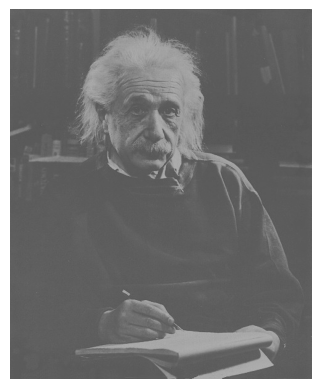

In [3]:
plt.imshow(original_image)
plt.axis('off')  # Hide axis
plt.show()

## Image nosing

In [4]:
if original_image is None:
    print("Error: Unable to load the image.")
else:
    def generate_film_grain(image):
        film_grain_noise = np.random.normal(loc=0, scale=20, size=image.shape).astype(np.uint8)
        return cv2.add(image, film_grain_noise)

    def generate_periodic(image):
        periodic_noise = np.zeros(image.shape, dtype=np.uint8)
        periodic_noise[::10, ::10, :] = 255
        return cv2.add(image, periodic_noise)

    def generate_speckle(image):
        speckle_noise = np.random.normal(loc=0, scale=0.1, size=image.shape) * 255
        return cv2.add(image, speckle_noise.astype(np.uint8))

    def generate_salt_and_pepper(image):
        salt_pepper_noise = np.random.choice([0, 255], size=image.shape[:2] + (image.shape[2],), p=[0.99, 0.01]).astype(np.uint8)
        return cv2.add(image, salt_pepper_noise)

    def generate_gaussian(image):
        gaussian_noise = np.random.normal(loc=0, scale=100, size=image.shape).astype(np.uint8)
        return cv2.add(image, gaussian_noise)

    noise_generators = {
        'Film Grain': generate_film_grain,
        'Periodic': generate_periodic,
        'Speckle': generate_speckle,
        'Salt-and-Pepper': generate_salt_and_pepper,
        'Gaussian': generate_gaussian
    }

    noisy_images = {noise_type: noise_generator(original_image) for noise_type, noise_generator in noise_generators.items()}

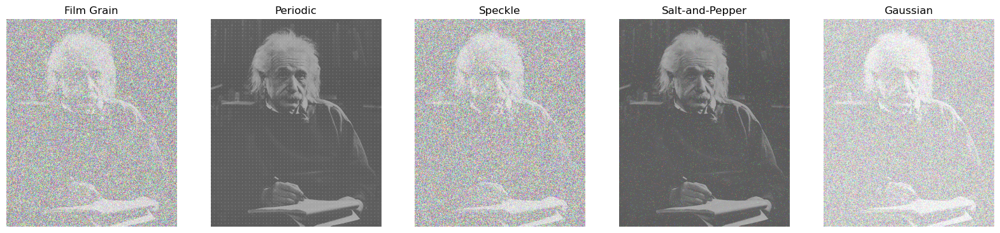

In [5]:
plt.figure(figsize=(20, 10))
for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
        plt.subplot(1, len(noisy_images), i)
        plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
        plt.title(noise_type)
        plt.axis('off')
plt.show()

## Linear Filtering

### Box Filter

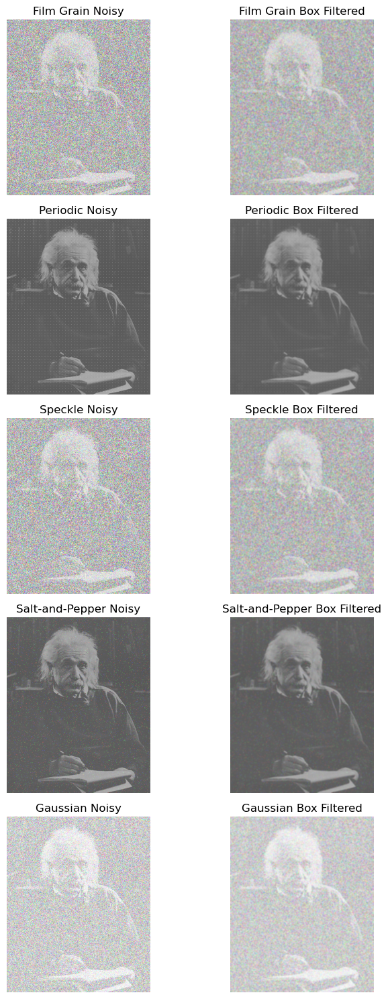

In [6]:
def apply_box_filter(image):
    return cv2.boxFilter(image, -1, (5, 5))

plt.figure(figsize=(8, 15))

for noise_type, noisy_image in noisy_images.items():
    plt.subplot(len(noisy_images), 2, 2*(list(noisy_images.keys()).index(noise_type)) + 1)
    plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    box_filtered = apply_box_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*(list(noisy_images.keys()).index(noise_type)) + 2)
    plt.imshow(cv2.cvtColor(box_filtered, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Box Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('box_filter_ppt.png', bbox_inches='tight')
plt.show()

### Gaussian Filter

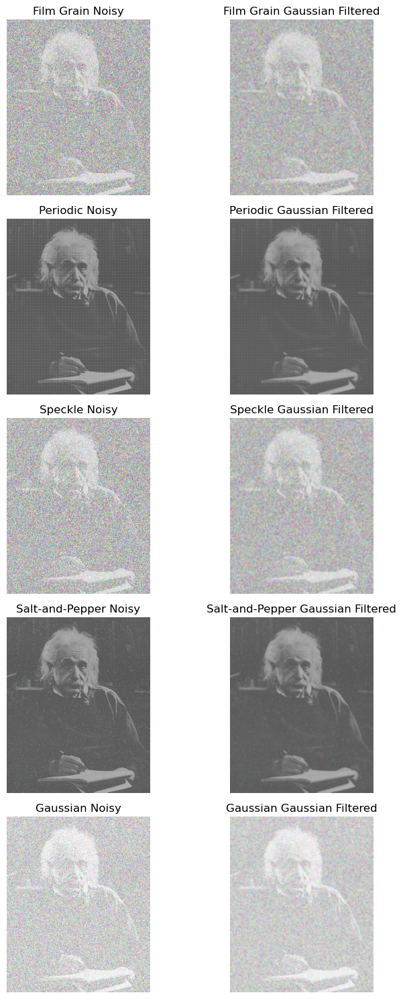

In [7]:
def apply_gaussian_filter(image):
    return cv2.GaussianBlur(image, (11, 11), sigmaX=1.5)

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    gaussian_filtered = apply_gaussian_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(cv2.cvtColor(gaussian_filtered, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Gaussian Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('gaussian_filter_ppt.png', bbox_inches='tight')
plt.show()

### Sobel

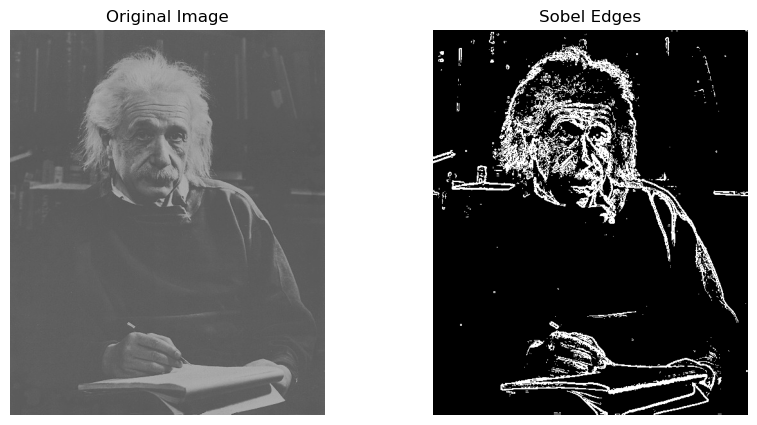

In [8]:
if original_image is None:
    print("Error: Unable to load the image.")
else:
    sobel_x = cv2.Sobel(original_image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(original_image, cv2.CV_64F, 0, 1, ksize=3)

    sobel_mag = np.sqrt(sobel_x**2 + sobel_y**2)

    threshold = 38
    sobel_edges = np.where(sobel_mag > threshold, 255, 0).astype(np.uint8)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(sobel_edges, cmap='gray')
    plt.title('Sobel Edges')
    plt.axis('off')

    plt.savefig('sobel_filter_ppt.png', bbox_inches='tight')
    plt.show()

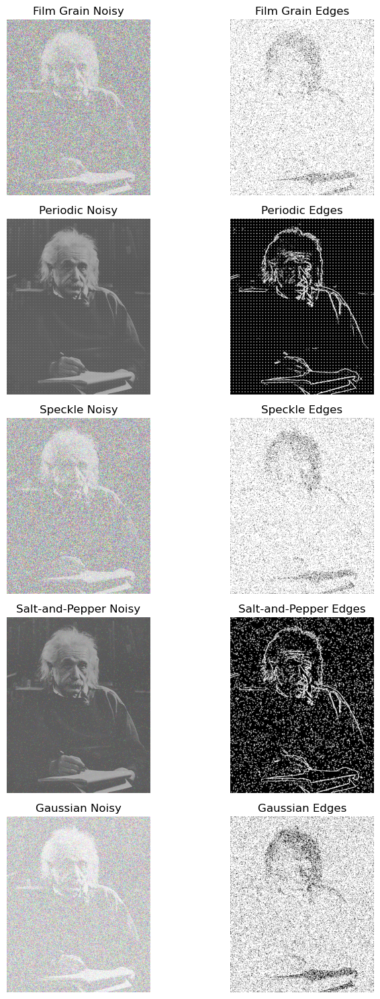

In [9]:
def detect_edges(image):
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    sobel_mag = np.sqrt(sobel_x**2 + sobel_y**2)
    threshold = 70
    sobel_edges = np.where(sobel_mag > threshold, 255, 0).astype(np.uint8)
    return sobel_edges

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    edges = detect_edges(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY))
    plt.imshow(edges, cmap='gray')
    plt.title(noise_type + ' Edges', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('sobel_filter2_ppt.png', bbox_inches='tight')
plt.show()

## Non-linear Filtering

### Median Filter

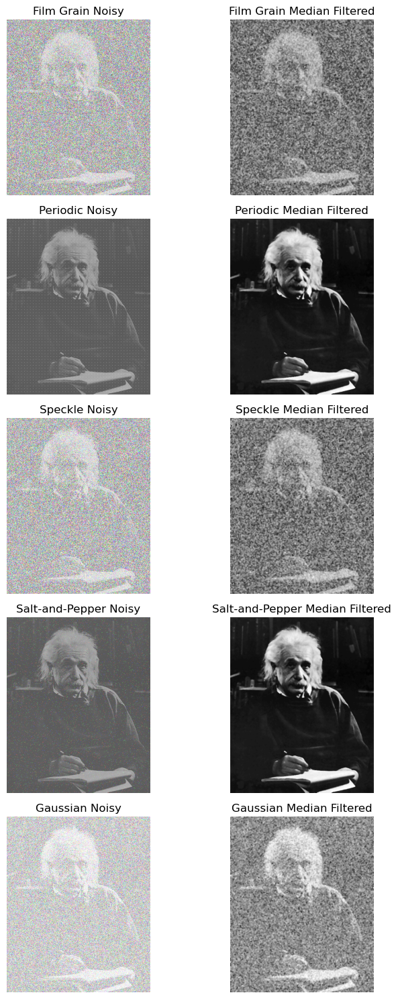

In [10]:
def apply_median_filter(image):
    return cv2.medianBlur(image, 5)

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    noisy_image_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
    median_filtered = apply_median_filter(noisy_image_gray)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(median_filtered, cmap='gray')
    plt.title(noise_type + ' Median Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('median_filter_ppt.png', bbox_inches='tight')
plt.show()

### Rank Filter

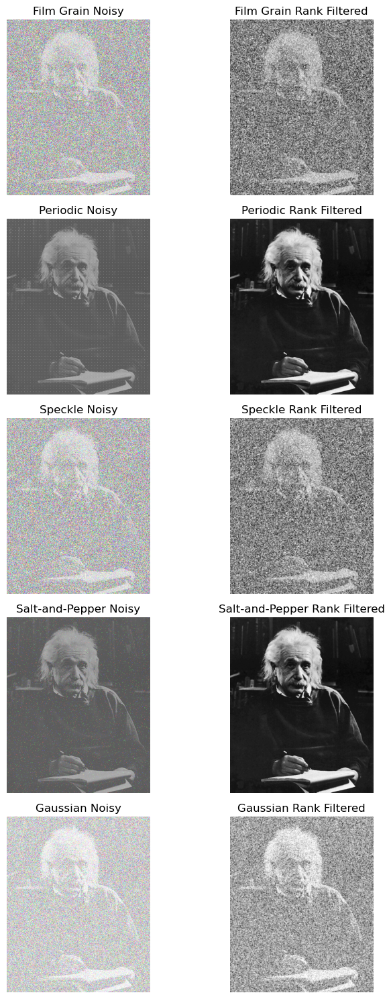

In [11]:
def apply_rank_filter(image):
    kernel_size = 3
    rank = 4

    padded_image = cv2.copyMakeBorder(image, 1, 1, 1, 1, cv2.BORDER_REPLICATE)
    filtered_image = np.zeros_like(image)

    for y in range(image.shape[0]):
        for x in range(image.shape[1]):
            neighborhood = padded_image[y:y+kernel_size, x:x+kernel_size]
            sorted_neighborhood = np.sort(neighborhood.flatten())
            filtered_image[y, x] = sorted_neighborhood[rank]

    return filtered_image

num_noises = len(noisy_images)
num_images = num_noises

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    noisy_image_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
    rank_filtered = apply_rank_filter(noisy_image_gray)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(rank_filtered, cmap='gray')
    plt.title(noise_type + ' Rank Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('rank_filter_ppt.png', bbox_inches='tight')
plt.show()

### Adaptive Filter

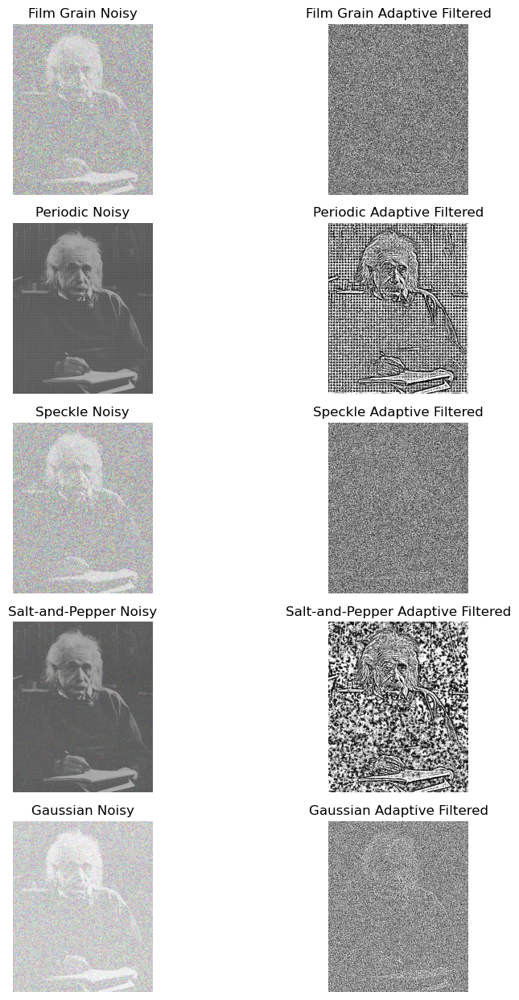

In [12]:
def apply_adaptive_filter(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.adaptiveThreshold(gray_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

num_noises = len(noisy_images)
num_images = num_noises + 1

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
    plt.subplot(num_images, 2, i * 2 - 1)
    plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Noisy')
    plt.axis('off')

    adaptive_filtered = apply_adaptive_filter(noisy_image)

    plt.subplot(num_images, 2, i * 2)
    plt.imshow(adaptive_filtered, cmap='gray')
    plt.title(noise_type + ' Adaptive Filtered')
    plt.axis('off')

plt.tight_layout()
plt.savefig('adaptive_filter_ppt.png', bbox_inches='tight')
plt.show()

### Bilateral Filter

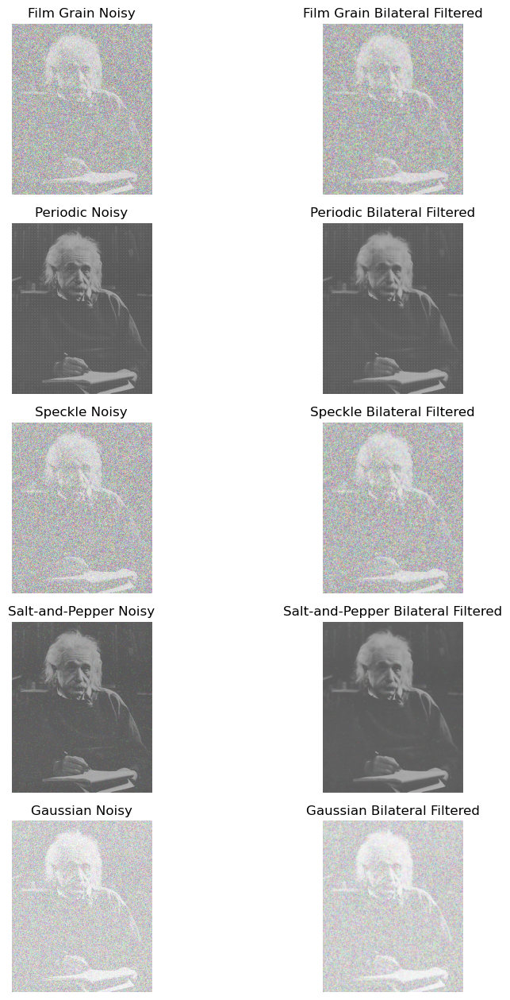

In [13]:
def apply_bilateral_filter(image):
    return cv2.bilateralFilter(image, 9, 75, 75)

num_noises = len(noisy_images)
num_images = num_noises + 1

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
    plt.subplot(num_images, 2, i * 2 + 1)
    plt.imshow(cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Noisy')
    plt.axis('off')

    bilateral_filtered = apply_bilateral_filter(noisy_image)

    plt.subplot(num_images, 2, i * 2 + 2)
    plt.imshow(cv2.cvtColor(bilateral_filtered, cv2.COLOR_BGR2RGB))
    plt.title(noise_type + ' Bilateral Filtered')
    plt.axis('off')

plt.tight_layout()
plt.savefig('bilateral_filter_ppt.png', bbox_inches='tight')
plt.show()

# Image Filtering on colour image

In [14]:
image_path = "I:/My Drive/Image_filtering/images/images/animated1.jpg"
# image_path = "/Users/user/Downloads/images/animated1.jpg"
bgr_image = cv2.imread(image_path)
original_image = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)

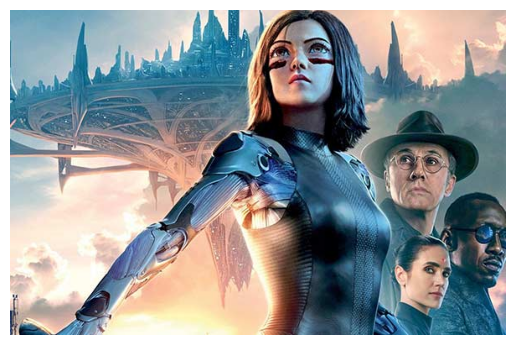

In [15]:
plt.imshow(original_image)
plt.axis('off')
plt.show()

In [16]:
if original_image is None:
    print("Error: Unable to load the image.")
else:
    def generate_film_grain(image):
        film_grain_noise = np.random.normal(loc=1, scale=1, size=image.shape).astype(np.uint8)
        return cv2.add(image, film_grain_noise)

    def generate_periodic(image):
        periodic_noise = np.zeros(image.shape, dtype=np.uint8)
        periodic_noise[::5, ::5, :] = 255
        return cv2.add(image, periodic_noise)

    def generate_speckle(image):
        speckle_noise = np.random.normal(loc=1, scale=0.5, size=image.shape) * 255
        return cv2.add(image, speckle_noise.astype(np.uint8))

    def generate_salt_and_pepper(image):
        salt_pepper_noise = np.random.choice([0, 255], size=image.shape[:2] + (image.shape[2],), p=[0.89, 0.11]).astype(np.uint8)
        return cv2.add(image, salt_pepper_noise)

    def generate_gaussian(image):
        gaussian_noise = np.random.normal(loc=1, scale=2, size=image.shape).astype(np.uint8)
        return cv2.add(image, gaussian_noise)

    noise_generators = {
        'Film Grain': generate_film_grain,
        'Periodic': generate_periodic,
        'Speckle': generate_speckle,
        'Salt-and-Pepper': generate_salt_and_pepper,
        'Gaussian': generate_gaussian
    }

    noisy_images = {noise_type: noise_generator(original_image) for noise_type, noise_generator in noise_generators.items()}

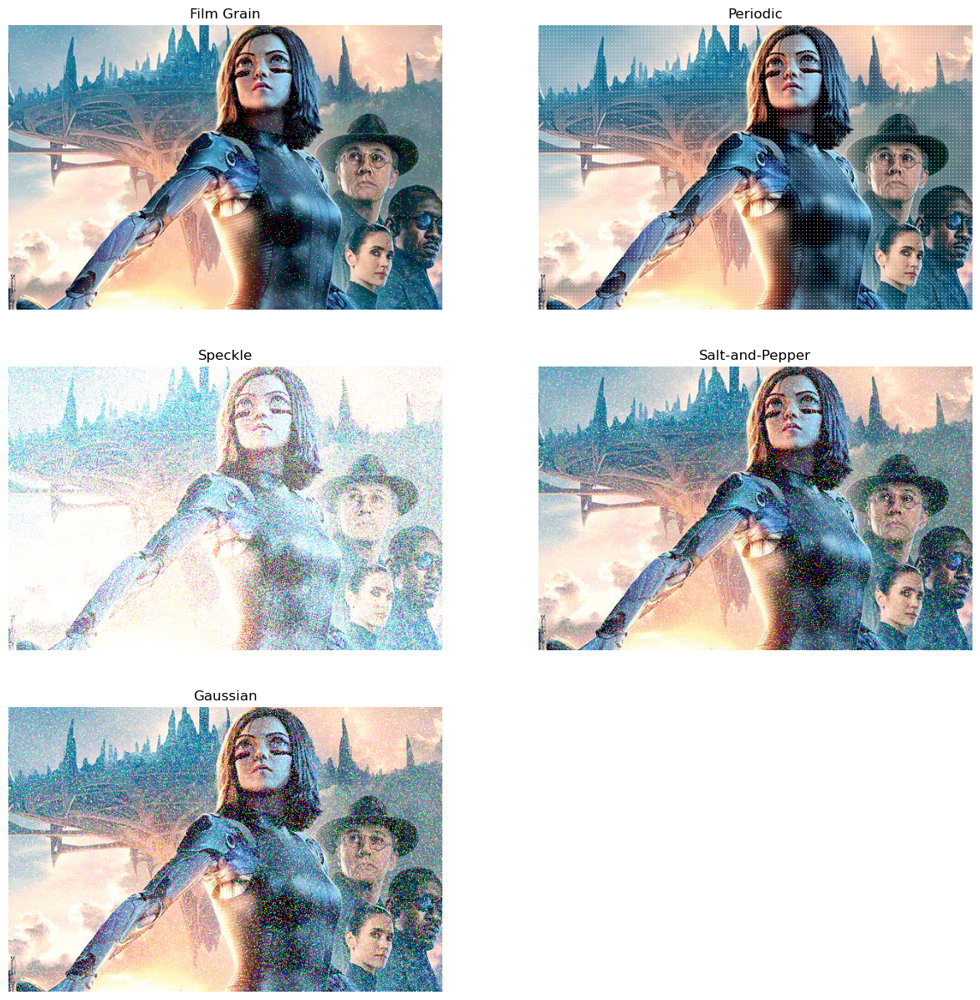

In [17]:
plt.figure(figsize=(15, 15))
for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
        plt.subplot(3, 2, i)
        plt.imshow(noisy_image)
        plt.title(noise_type)
        plt.axis('off')
plt.show()

## Linear Filtering

### BOX Filter

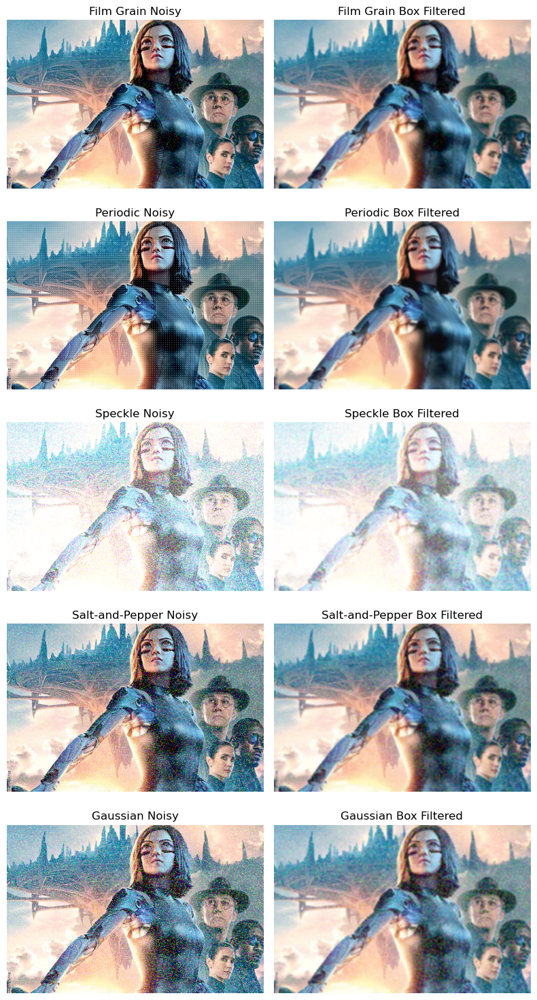

In [18]:
def apply_box_filter(image):
    return cv2.boxFilter(image, -1, (5, 5))

plt.figure(figsize=(8, 15))

for noise_type, noisy_image in noisy_images.items():
    plt.subplot(len(noisy_images), 2, 2*(list(noisy_images.keys()).index(noise_type)) + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    box_filtered = apply_box_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*(list(noisy_images.keys()).index(noise_type)) + 2)
    plt.imshow(box_filtered)
    plt.title(noise_type + ' Box Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('box_filter_output.png', bbox_inches='tight')
plt.show()

### Gaussian Filter

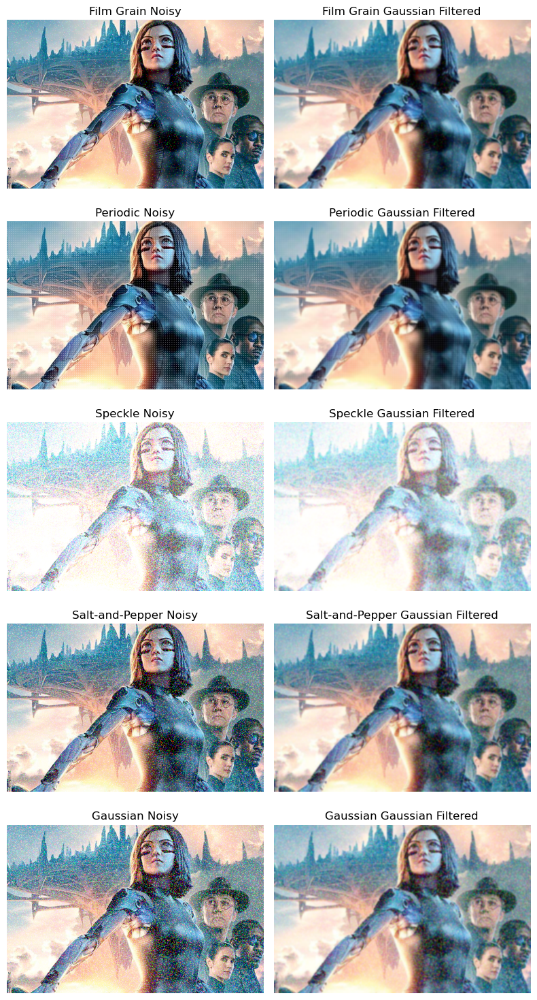

In [19]:
def apply_gaussian_filter(image):
    return cv2.GaussianBlur(image, (11, 11), sigmaX=1.5)

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    gaussian_filtered = apply_gaussian_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(gaussian_filtered)
    plt.title(noise_type + ' Gaussian Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('gaussian_filter_output.png', bbox_inches='tight')
plt.show()

### Sobel

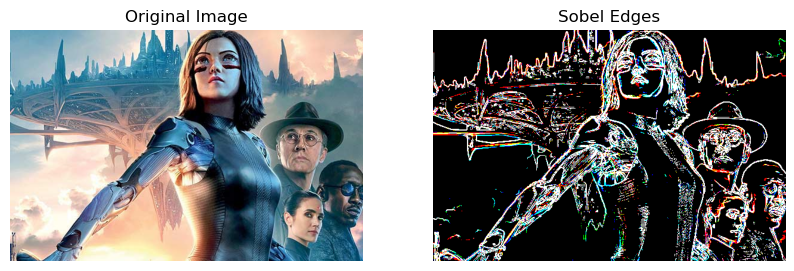

In [20]:
if original_image is None:
    print("Error: Unable to load the image.")
else:
    sobel_x = cv2.Sobel(original_image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(original_image, cv2.CV_64F, 0, 1, ksize=3)

    sobel_mag = np.sqrt(sobel_x**2 + sobel_y**2)

    threshold = 130
    sobel_edges = np.where(sobel_mag > threshold, 255, 0).astype(np.uint8)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(sobel_edges, cmap='gray')
    plt.title('Sobel Edges')
    plt.axis('off')
    plt.savefig('sobel_filter_output.png', bbox_inches='tight')
    plt.show()

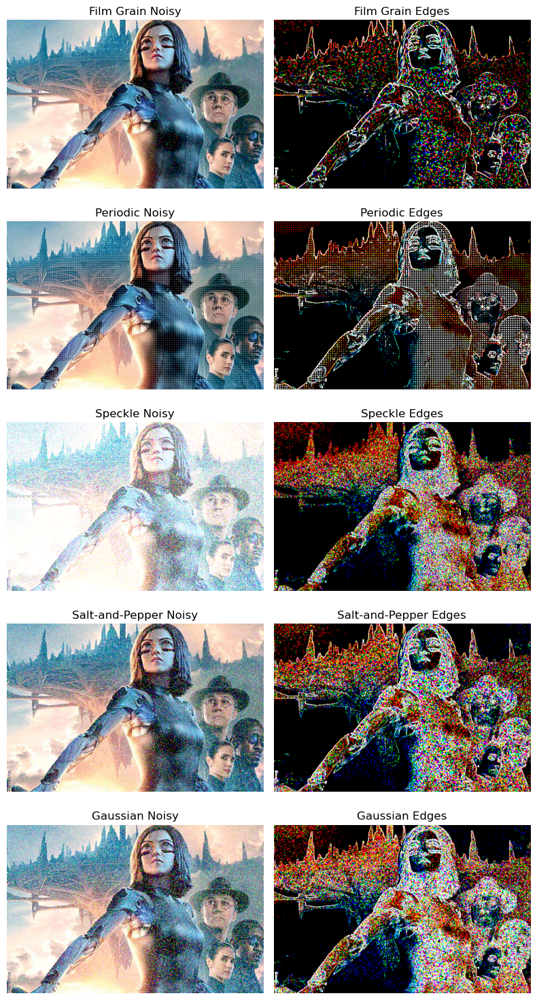

In [21]:
def detect_edges(image):
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    sobel_mag = np.sqrt(sobel_x**2 + sobel_y**2)
    threshold = 255
    sobel_edges = np.where(sobel_mag > threshold, 255, 0).astype(np.uint8)
    return sobel_edges

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    edges = detect_edges(noisy_image)
    plt.imshow(edges, cmap='gray')
    plt.title(noise_type + ' Edges', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('sobel_filter2_output.png', bbox_inches='tight')
plt.show()

## Non-linear Filtering

### Median Filter

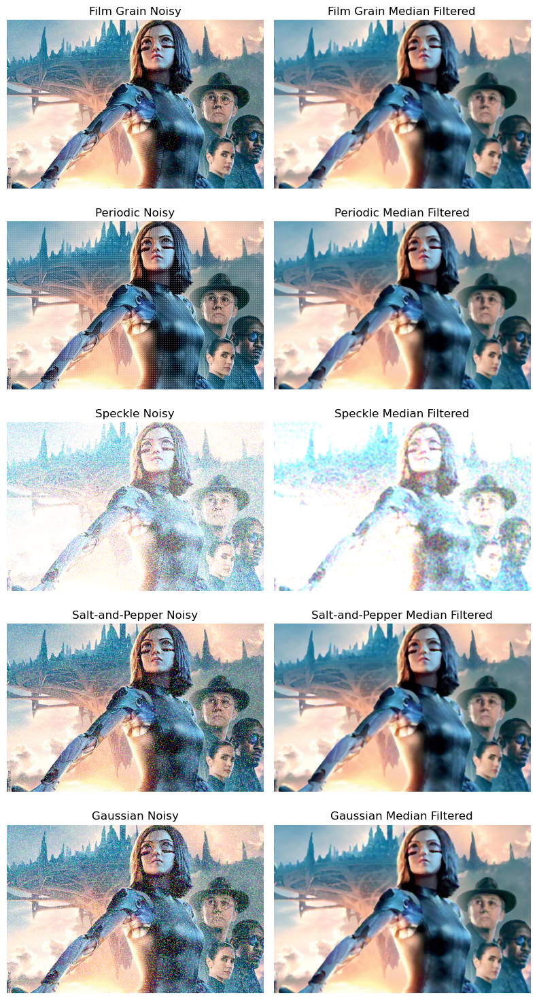

In [22]:
def apply_median_filter(image):
    return cv2.medianBlur(image, 5)

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    # noisy_image_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
    median_filtered = apply_median_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(median_filtered, cmap='gray')
    plt.title(noise_type + ' Median Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('median_filter_output.png', bbox_inches='tight')
plt.show()

### Rank Filter

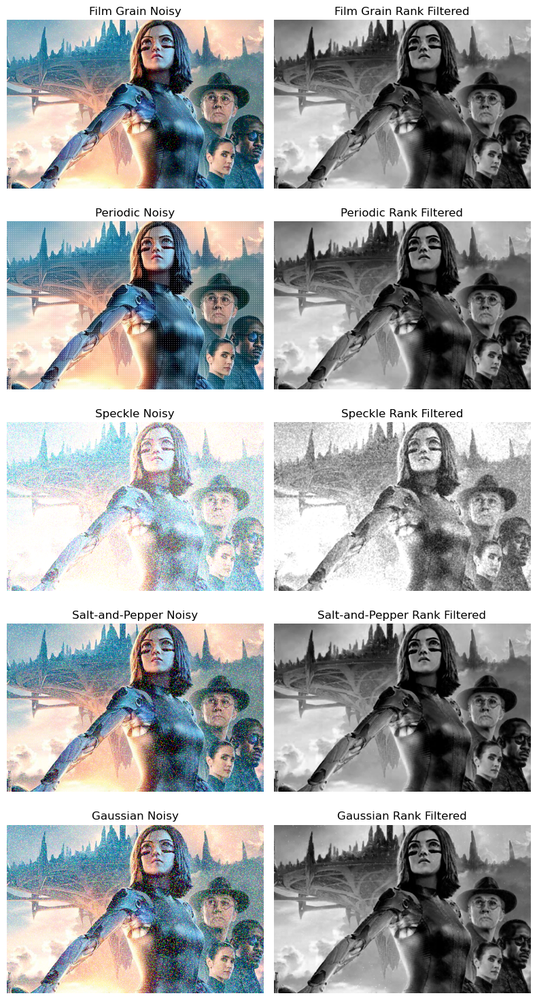

In [23]:
def apply_rank_filter(image):
    kernel_size = 3
    rank = 4

    padded_image = cv2.copyMakeBorder(image, 1, 1, 1, 1, cv2.BORDER_REPLICATE)
    filtered_image = np.zeros_like(image)

    for y in range(image.shape[0]):
        for x in range(image.shape[1]):
            neighborhood = padded_image[y:y+kernel_size, x:x+kernel_size]
            sorted_neighborhood = np.sort(neighborhood.flatten())
            filtered_image[y, x] = sorted_neighborhood[rank]

    return filtered_image

num_noises = len(noisy_images)
num_images = num_noises

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    # noisy_image_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
    rank_filtered = apply_rank_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(rank_filtered)
    plt.title(noise_type + ' Rank Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('rank_filter_output.png', bbox_inches='tight')
plt.show()

### Adaptive Filter

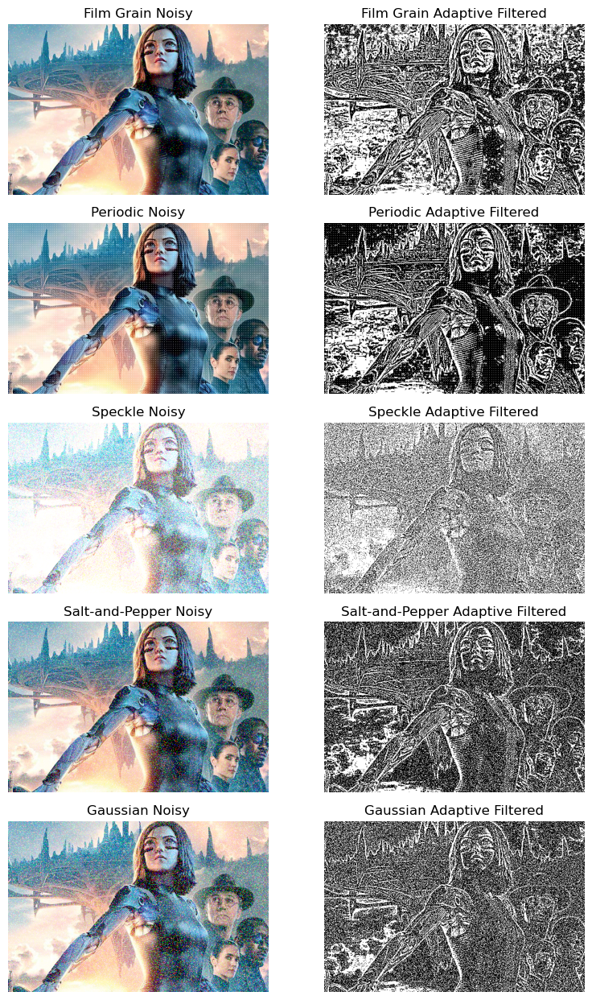

In [24]:
def apply_adaptive_filter(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.adaptiveThreshold(gray_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

num_noises = len(noisy_images)
num_images = num_noises + 1

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
    plt.subplot(num_images, 2, i * 2 - 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy')
    plt.axis('off')

    adaptive_filtered = apply_adaptive_filter(noisy_image)

    plt.subplot(num_images, 2, i * 2)
    plt.imshow(adaptive_filtered, cmap='gray')
    plt.title(noise_type + ' Adaptive Filtered')
    plt.axis('off')

plt.tight_layout()
plt.savefig('adaptive_filter_output.png', bbox_inches='tight')
plt.show()

### Bilateral Filter

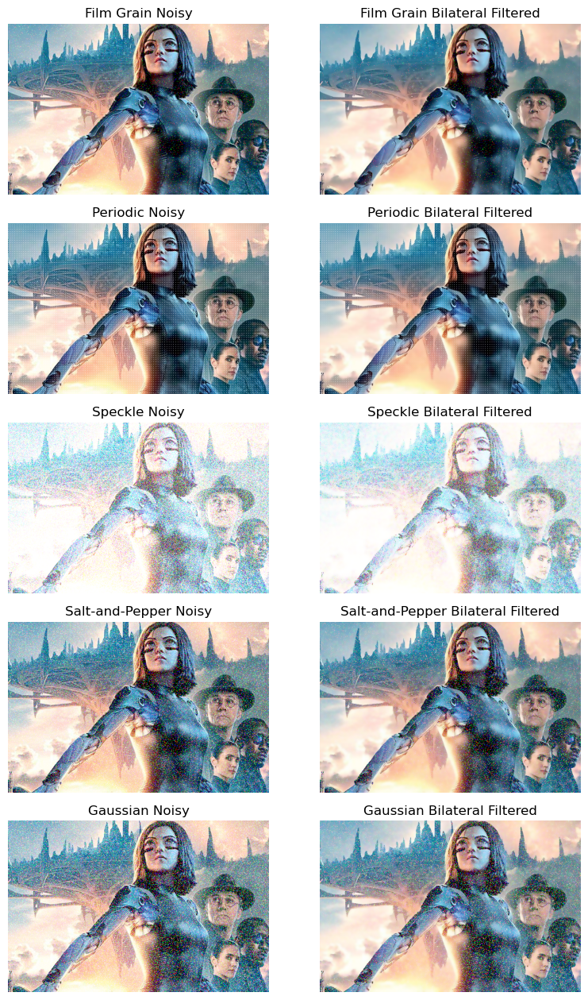

In [25]:
def apply_bilateral_filter(image):
    return cv2.bilateralFilter(image, 9, 75, 75)

num_noises = len(noisy_images)
num_images = num_noises + 1

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
    plt.subplot(num_images, 2, i * 2 + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy')
    plt.axis('off')

    bilateral_filtered = apply_bilateral_filter(noisy_image)

    plt.subplot(num_images, 2, i * 2 + 2)
    plt.imshow(bilateral_filtered)
    plt.title(noise_type + ' Bilateral Filtered')
    plt.axis('off')

plt.tight_layout()
# Save the generated output
plt.savefig('output.png', bbox_inches='tight')
plt.savefig('bilateral_filter_output.png', bbox_inches='tight')
plt.show()

# Gray Scale Imaging

## Average Method

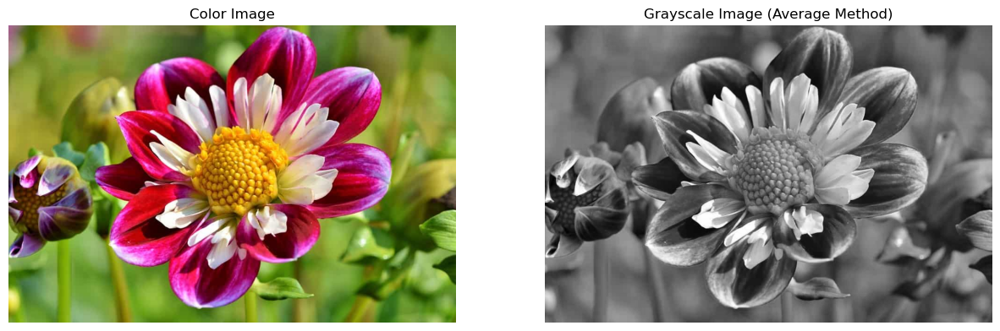

In [26]:
def average_method(img):
    grayscale_img = np.mean(img, axis=2)

    grayscale_img = np.uint8(grayscale_img)

    return grayscale_img

color_img = cv2.imread("I:/My Drive/Image_filtering/images/images/flower1.jpg")

grayscale_img_avg = average_method(color_img)

org = cv2.cvtColor(color_img, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 15))

plt.subplot(1,2,1)
plt.imshow(org)
plt.title('Color Image')
plt.axis('off')  # Hide axis

plt.subplot(1,2,2)
plt.imshow(grayscale_img_avg, cmap='gray')  # Specify grayscale colormap
plt.title('Grayscale Image (Average Method)')
plt.axis('off')  # Hide axis

plt.show()

## Luminosity Method

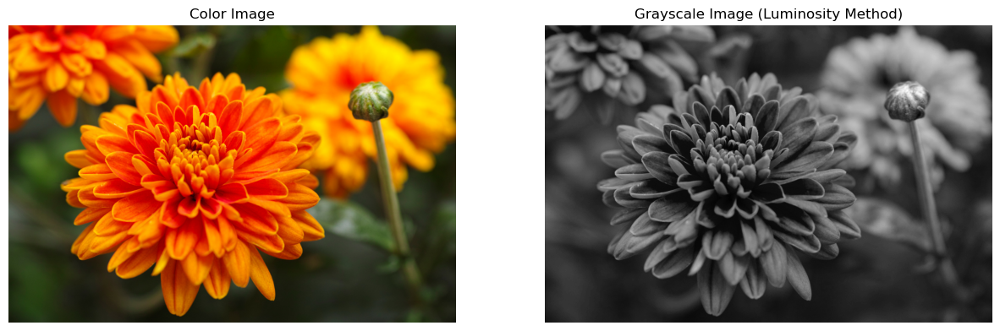

In [27]:
def luminosity_method(img):
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    grayscale_img = 0.21 * R + 0.72 * G + 0.07 * B
    grayscale_img = np.uint8(grayscale_img)

    return grayscale_img

color_img = cv2.imread("I:/My Drive/Image_filtering/images/images/flower.jpg")

# Convert the color image to grayscale using the luminosity method
grayscale_img_lum = luminosity_method(color_img)

org = cv2.cvtColor(color_img, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 15))

plt.subplot(1,2,1)
plt.imshow(org)
plt.title('Color Image')
plt.axis('off')  # Hide axis

plt.subplot(1,2,2)
plt.imshow(grayscale_img_lum, cmap='gray')  # Specify grayscale colormap
plt.title('Grayscale Image (Luminosity Method)')
plt.axis('off')  # Hide axis

plt.show()

## Single Channel Method

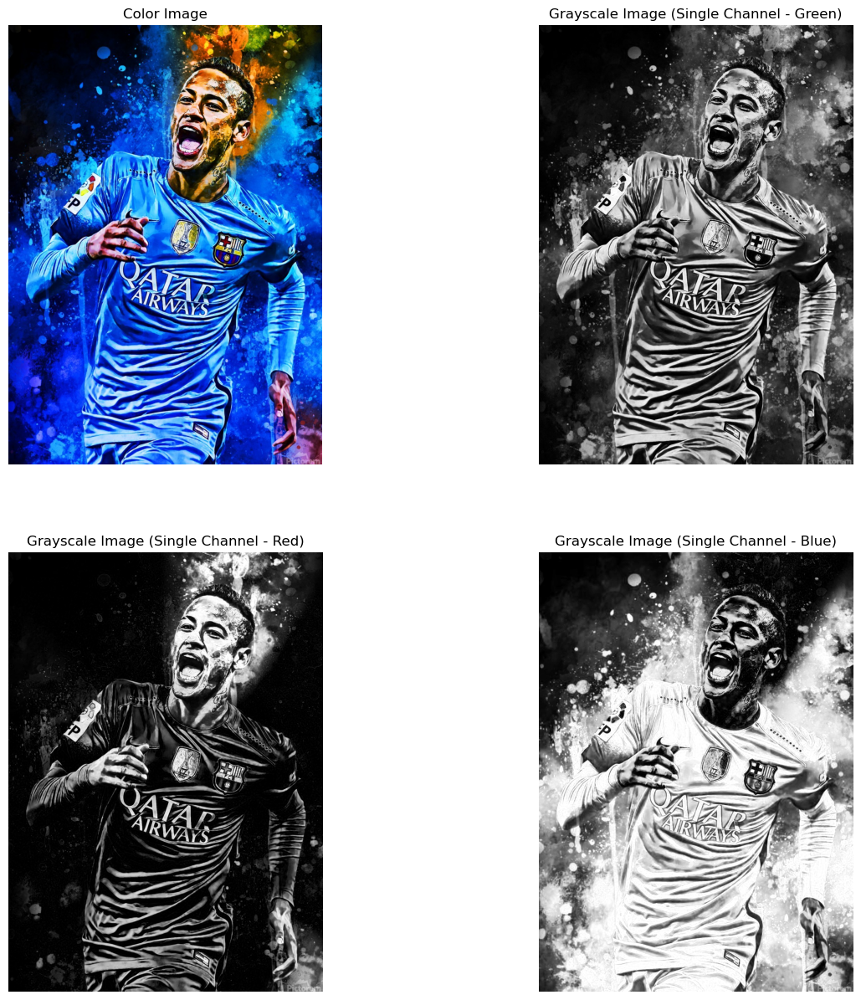

In [28]:
color_img = cv2.imread("I:/My Drive/Image_filtering/images/images/animated2.jpg")

green_channel = color_img[:,:,1]

# Extract the red channel
red_channel = color_img[:,:,2]

# Extract the blue channel
blue_channel = color_img[:,:,0]

org = cv2.cvtColor(color_img, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 15))

plt.subplot(2,2,1)
plt.imshow(org)
plt.title('Color Image')
plt.axis('off')  # Hide axis

plt.subplot(2,2,2)
plt.imshow(green_channel , cmap='gray')  # Specify grayscale colormap
plt.title('Grayscale Image (Single Channel - Green)')
plt.axis('off')  # Hide axis

plt.subplot(2,2,3)
plt.imshow(red_channel , cmap='gray')  # Specify grayscale colormap
plt.title('Grayscale Image (Single Channel - Red)')
plt.axis('off')  # Hide axis

plt.subplot(2,2,4)
plt.imshow(blue_channel , cmap='gray')  # Specify grayscale colormap
plt.title('Grayscale Image (Single Channel - Blue)')
plt.axis('off')  # Hide axis

plt.show()

# Image Blurring

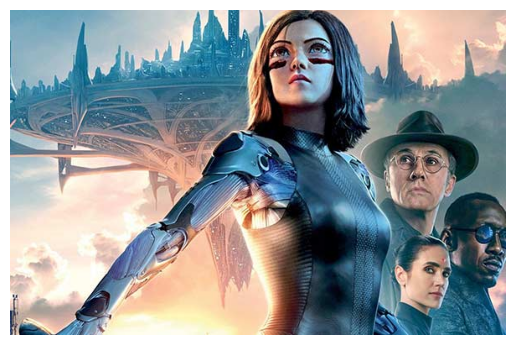

In [29]:
image_path = "I:/My Drive/Image_filtering/images/images/animated1.jpg"
# image_path = "/Users/user/Downloads/images/animated1.jpg"
bgr_image = cv2.imread(image_path)
img = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off')  # Hide axis
plt.show()

In [30]:
averaging_blur = cv2.blur(img, (11, 11))
gaussian_blur = cv2.GaussianBlur(img, (11, 11), 0)
bilateral_blur = cv2.bilateralFilter(img, 9, 75, 75)
median_blur = cv2.medianBlur(img, 11)

In [31]:
display_size = (200, 200)
original_display = cv2.resize(img, display_size)

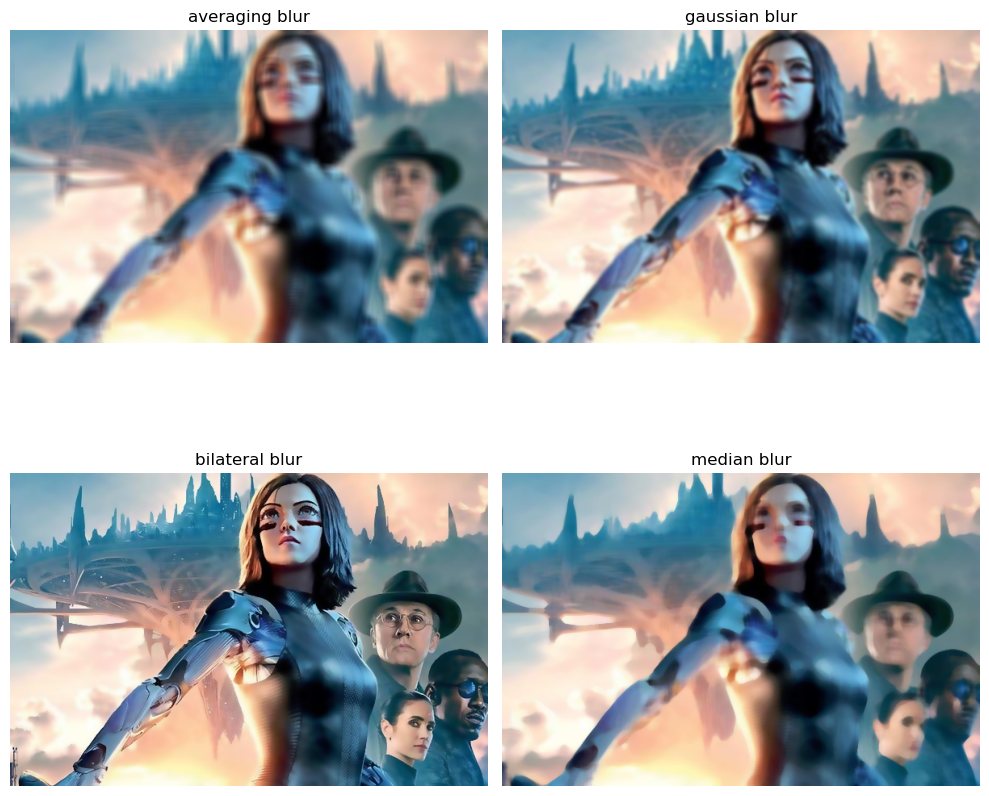

In [32]:
plt.figure(figsize=(10, 10))

plt.subplot(2,2,1)
plt.imshow(averaging_blur)
plt.title('averaging blur')
plt.axis('off')  # Hide axis

plt.subplot(2,2,2)
plt.imshow(gaussian_blur)
plt.title('gaussian blur')
plt.axis('off')  # Hide axis

plt.subplot(2,2,3)
plt.imshow(bilateral_blur)
plt.title('bilateral blur')
plt.axis('off')

plt.subplot(2,2,4)
plt.imshow(median_blur)
plt.title('median blur')
plt.axis('off')

plt.tight_layout()
plt.show()

# Histogram based image analysis

In [33]:
image_path = "I:/My Drive/Image_filtering/images/images/Fig0310(b)(washed_out_pollen_image).tif"
image = Image.open(image_path).convert('L')

In [34]:
def histogram_equalization(image):
    # Calculate histogram
    hist, bins = np.histogram(image.flatten(), 256, [0,256])
    
    # Calculate cumulative distribution function
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()
    
    # Perform histogram equalization
    cdf_m = np.ma.masked_equal(cdf, 0)
    cdf_m = (cdf_m - cdf_m.min())*255 / (cdf_m.max()-cdf_m.min())
    cdf = np.ma.filled(cdf_m, 0).astype('uint8')
    
    # Apply histogram equalization
    equalized_image = cdf[image]
    
    return equalized_image, hist

In [35]:
equalized_image, hist = histogram_equalization(np.array(image))

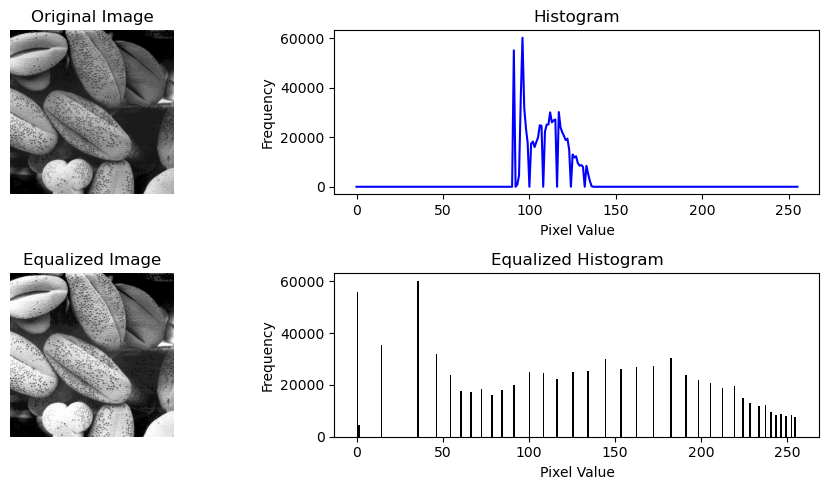

In [36]:
plt.figure(figsize=(10, 5))
plt.subplot(2, 2, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(equalized_image, cmap='gray')
plt.title('Equalized Image')
plt.axis('off')

# Display histogram
plt.subplot(2, 2, 2)
plt.plot(hist, color='blue')
plt.title('Histogram')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')

plt.subplot(2, 2, 4)
plt.hist(equalized_image.flatten(), 256, [0,256], color='black')
plt.title('Equalized Histogram')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

In [37]:
image_path = "I:/My Drive/Image_filtering/images/images/Fig0354(a)(einstein_orig).tif"
image = Image.open(image_path).convert('L')

In [38]:
def histogram_equalization(image):
    # Calculate histogram
    hist, bins = np.histogram(image.flatten(), 256, [0,256])
    
    # Calculate cumulative distribution function
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max() / cdf.max()
    
    # Perform histogram equalization
    cdf_m = np.ma.masked_equal(cdf, 0)
    cdf_m = (cdf_m - cdf_m.min())*255 / (cdf_m.max()-cdf_m.min())
    cdf = np.ma.filled(cdf_m, 0).astype('uint8')
    
    # Apply histogram equalization
    equalized_image = cdf[image]
    
    return equalized_image, hist, cdf

In [39]:
equalized_image, hist_original, cdf_equalized = histogram_equalization(np.array(image))

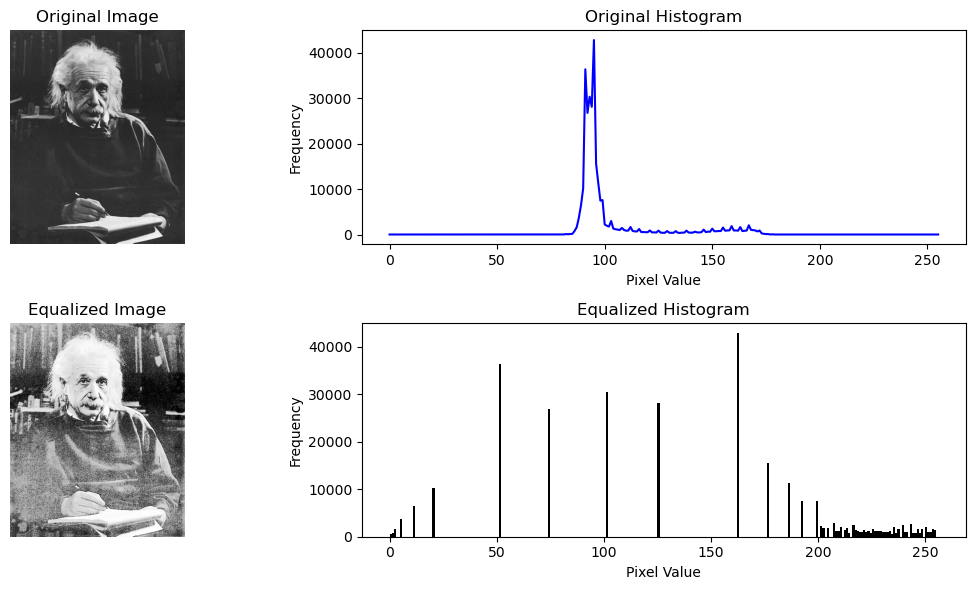

In [40]:
plt.figure(figsize=(12, 6))

plt.subplot(2, 2, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(equalized_image, cmap='gray')
plt.title('Equalized Image')
plt.axis('off')

# Display histograms
plt.subplot(2, 2, 2)
plt.plot(hist_original, color='blue')
plt.title('Original Histogram')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')

plt.subplot(2, 2, 4)
plt.hist(equalized_image.flatten(), 256, [0,256], color='black')
plt.title('Equalized Histogram')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# Image Scaling

## Nearest neighbor

In [41]:
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display

In [42]:
# original_img = Image.open("/Users/user/Downloads/animated2.jpg")
original_img = Image.open("I:/My Drive/Image_filtering/images/images/animated2.jpg")

original_width, original_height = original_img.size

new_width = original_width // 2
new_height = original_height // 2

In [43]:
resized_img = original_img.resize((new_width, new_height), resample=Image.NEAREST)

In [44]:
# plt.figure(figsize=(12, 6))

# plt.subplot(1, 2, 1)
# plt.imshow(original_img)
# plt.title('Original Image')

# plt.subplot(1, 2, 2)
# plt.imshow(resized_img)
# plt.title('Equalized Image')

# plt.tight_layout()
# plt.show()

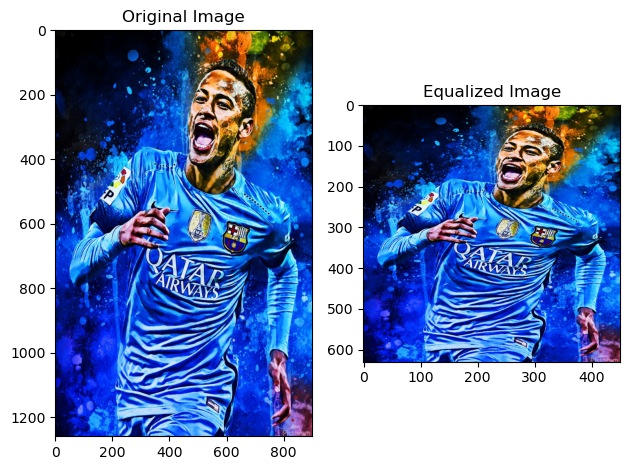

In [45]:
original_width, original_height = original_img.size

plt.subplot(1, 2, 1)
plt.imshow(original_img)
plt.title('Original Image')
plt.gca().set_aspect('auto')  # Ensure the aspect ratio is automatic

plt.subplot(1, 2, 2)
plt.imshow(resized_img)
plt.title('Equalized Image')
plt.gca().set_aspect(original_width/original_height)  # Set aspect ratio based on original image dimensions

plt.tight_layout()
plt.show()

## Bilinar Interpolation

In [46]:
resized_img = original_img.resize((new_width, new_height), resample=Image.BILINEAR)

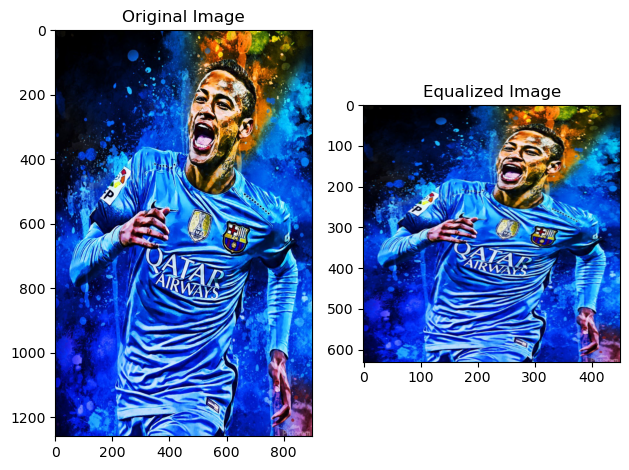

In [47]:
original_width, original_height = original_img.size

plt.subplot(1, 2, 1)
plt.imshow(original_img)
plt.title('Original Image')
plt.gca().set_aspect('auto')  # Ensure the aspect ratio is automatic

plt.subplot(1, 2, 2)
plt.imshow(resized_img)
plt.title('Equalized Image')
plt.gca().set_aspect(original_width/original_height)  # Set aspect ratio based on original image dimensions

plt.tight_layout()
plt.show()

## Bicubic Interpolation

In [48]:
resized_img = original_img.resize((new_width, new_height), resample=Image.BICUBIC)

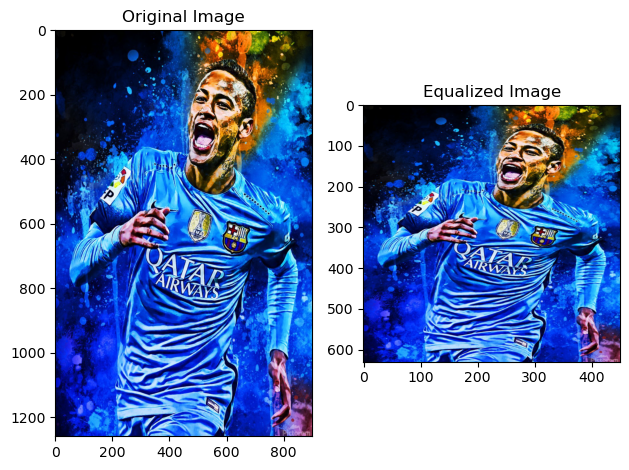

In [49]:
original_width, original_height = original_img.size

plt.subplot(1, 2, 1)
plt.imshow(original_img)
plt.title('Original Image')
plt.gca().set_aspect('auto')  # Ensure the aspect ratio is automatic

plt.subplot(1, 2, 2)
plt.imshow(resized_img)
plt.title('Equalized Image')
plt.gca().set_aspect(original_width/original_height)  # Set aspect ratio based on original image dimensions

plt.tight_layout()
plt.show()

## Lanczos Interpolation

In [50]:
resized_img = original_img.resize((new_width, new_height), resample=Image.LANCZOS)

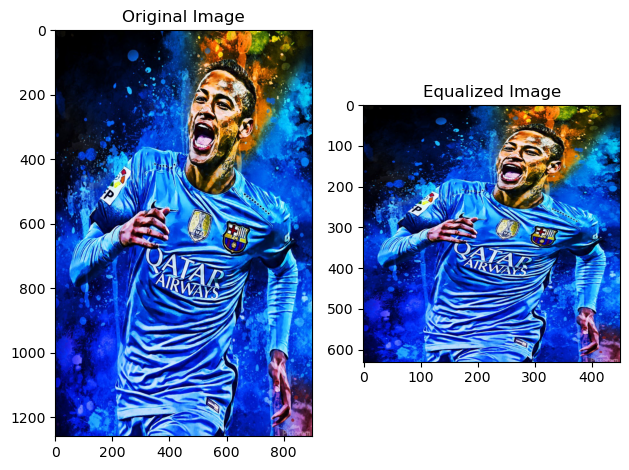

In [51]:
original_width, original_height = original_img.size

plt.subplot(1, 2, 1)
plt.imshow(original_img)
plt.title('Original Image')
plt.gca().set_aspect('auto')  # Ensure the aspect ratio is automatic

plt.subplot(1, 2, 2)
plt.imshow(resized_img)
plt.title('Equalized Image')
plt.gca().set_aspect(original_width/original_height)  # Set aspect ratio based on original image dimensions

plt.tight_layout()
plt.show()